# Practical 4 - Seismic attribute analysis

This notebook aims to build on your investigation of 3D seismic volumes from practical 3 by providing methods which we can use to enhance the identification of certain geological/environmental features. This is achieved through seismic attributes, attributes use some mathematical calculation of the data to enhance features, very similar to image processing techniques. 

**Learning Objectives**:

1)	Understand that modern seismic data analysis involves calculating seismic attributes to reveal features more clearly
2)	Understand that new attributes can be designed or multiple attributes combined to improve imaging
3)	Give you an appreciation that modern seismic data analysis will require the development of more sophisticated data analysis techniques


In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
# Import required libraries
import numpy as np
import matplotlib.pyplot as plt
import segyio

In [4]:
import itertools
import scipy.ndimage

In [5]:
import pandas as pd

In [6]:
from mayavi import mlab

### 4.1 Explore a new 3D seismic data volume

We are going to start this exercise by loading a new 3D seismic data volume- Thebe_rift_faults. As we discussed in  lecture 6 this dataset comes from offshore NW Australia and shows some great examples of faults. This seismic datsets has time as the z-axis (ie it has not been depth converted yet).

In [7]:
base_segy = '../data/Thebe_rift_faults'
f = segyio.open(base_segy, ignore_geometry= True) #opens files like python default open call , assumes a well-structured 3D volume, 

In [8]:
print (segyio.tools.wrap(f.text[0])) #show text header to understand file better

C 1 SEGY OUTPUT FROM Petrel 2017.1 Thursday, November 18 2021 12:34:36
C 2 Name: FullStack_06-34degree Realized 1 Crop 2 Type: 3D seismic          C 3
C 4 First inline: 1753   Last inline: 2245
C 5 First xline:  2190   Last xline:  3063
C 6 CRS: Undefined
C 7 X min: 715563.75 max: 731309.44 delta: 15745.69
C 8 Y min: 7855437.24 max: 7871648.81 delta: 16211.58
C 9 Time min: -3193.50 max: -2383.50 delta: 810.00
C10 Lat min: - max: - delta: -
C11 Long min: - max: - delta: -
C12 Trace min: -3192.00 max: -2385.00 delta: 807.00
C13 Seismic (template) min: -9375.49 max: 12558.00 delta: 21933.49
C14 Amplitude (data) min: -9375.49 max: 12558.00 delta: 21933.49
C15 Trace sample format: IEEE floating point
C16 Coordinate scale factor: 100.00000
C17
C18 Binary header locations:
C19 Sample interval             : bytes 17-18
C20 Number of samples per trace : bytes 21-22
C21 Trace date format           : bytes 25-26
C22
C23 Trace header locations:
C24 Inline number               : bytes 5-8
C25 Xline

In [9]:
data = segyio.tools.cube(base_segy) #extremely easy for well structured data

In [10]:
def explore3d(data_cube):
    """
    visualise data volume
    """
    source = mlab.pipeline.scalar_field(data_cube)
    source.spacing = [1, 1, -1]
    vm = np.percentile(data_cube, 95) #may need to play a little with the 95

    nx, ny, nz = data_cube.shape
    mlab.pipeline.image_plane_widget(source, plane_orientation='x_axes', 
                                     slice_index=nx//2, colormap='coolwarm', vmin=-vm, vmax=vm)
    mlab.pipeline.image_plane_widget(source, plane_orientation='y_axes', 
                                     slice_index=ny//2, colormap='coolwarm', vmin=-vm, vmax=vm)
    mlab.pipeline.image_plane_widget(source, plane_orientation='z_axes', 
                                     slice_index=nz//2, colormap='coolwarm', vmin=-vm, vmax=vm)
    mlab.show()

In [11]:
# explore3d(data)

**Ex 1: Spend some time looking through this data volume like you did in Exercise 3. Do you identify any interesting features that you recognise from the lecture 5 notes? If so, show some examples below:**

In the next part of the exercise you are going to use seismic attributes to try and highlight these geolgical features even further...

## 4.1.1. Attribute 1 - RMS amplitude

Amplitude attributes can be extracted along mapped horizons or from time/depth windows. RMS amplitude is just one example of an amplitude attribute. In this exercise we are going to calculate RMS between a time window. This involves squaring the amplitudes within the window and summing them, then square rooting. 

https://wiki.seg.org/wiki/RMS_amplitude

In [58]:
data.shape

(493, 874, 270)

In [60]:
np.ones(11)

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

In [59]:
RMS = np.zeros(data.shape)

for i in range(data.shape[0]):
    for j in range(data.shape[1]):
        trace = data[i,j,:]
        
        # Get RMS values
        trace_sq = np.square(trace) # square 
        kernel = np.ones(11)/11     # range over which we take the RMS value

        print(trace_sq.shape)
        
        # complete RMS calc
        RMS_amp = np.sqrt(np.convolve(trace_sq, kernel, 'same'))
        
        #store results
        RMS[i,j,:] = RMS_amp

(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)
(270,)

In [13]:
data.shape[0], data.shape[1]

(493, 874)

In [14]:
np.convolve(np.array([1, 2, 3, 4, 5]), [1, 1], 'same')

array([1, 3, 5, 7, 9])

In [15]:
# explore3d(RMS)

## 4.1.2. Attribute 2 - 1st vertical derivative in time

Any calculation you do with seismic data is a seismic attribute! New seismic attributes are invented all the time. You could invent your own! Some are really useful, and some less so... In this part of the exercise we will calcualte an attribute which is often found in seismic interpretation software- the 1st vertical derivative. This will highlight vertical gradients. Do you find this attribute highlights features any differently?

https://primer-computational-mathematics.github.io/book/d_geosciences/remote_sensing/Image_Filtering.html

In [16]:
diff1 = np.zeros(data.shape)
dt = (f.samples[1]-f.samples[0])
dt

3.0

In [17]:
diff1 = np.zeros(data.shape)
dt = (f.samples[1]-f.samples[0])

for i in range(data.shape[0]):
    for j in range(data.shape[1]):
        trace = data[i,j,:]

        # kernel = np.array([-1, 1])/dt  #forward difference? this is backward? https://en.wikipedia.org/wiki/Finite_difference
        kernel = np.array([1, -1])/dt  # forward difference

        # complete RMS calc
        diff = np.convolve(trace, kernel, 'same')
        
        #store results
        diff1[i,j,:] = diff

In [18]:
nums_to_check = 5

In [19]:
diff_test = diff1[0, 0, :][:nums_to_check]
diff_test

array([ 57.34246318, -86.01369985, -57.34246572, -28.67123413,
       -28.67123413])

In [20]:
trace_test = data[0,0,:][:nums_to_check]
trace_test

array([ 172.02739,  -86.01371, -258.0411 , -344.0548 , -430.0685 ],
      dtype=float32)

In [21]:
kernel = np.array([-1, 1])/dt
kernel

array([-0.33333333,  0.33333333])

In [22]:
np.convolve(trace_test, kernel, 'same')

array([-57.34246318,  86.01369985,  57.34246572,  28.67123413,
        28.67123413])

In [23]:
res = []
for i in range(0, nums_to_check):
    if i == 0:
        answer = (trace_test[i]) / dt
    else:
        answer = (trace_test[i] - trace_test[i-1]) / dt
    # print(f"{i} = {answer}")
    res.append(answer)
    
np.array(res)

array([ 57.34246318, -86.01370239, -57.34246826, -28.67123413,
       -28.67123413])

In [24]:
# explore3d(diff1)

Please note the effect that our vm parameter has here when optimising our dynamic range! If you use the same dynamic range for both the effects become a lot clearer!

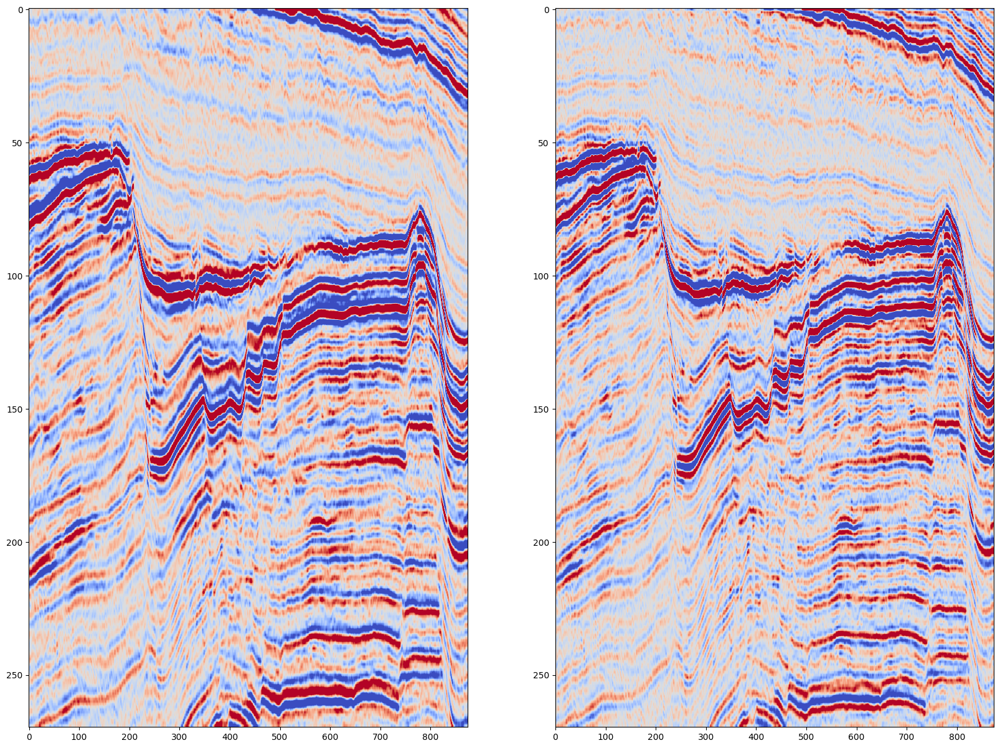

In [25]:
fig = plt.figure(figsize=(20,15))
ax1 = plt.subplot(121)
vm = np.percentile(data, 95)
ax1.imshow(data[0,:,:].T, cmap='coolwarm', aspect='auto', vmin=-vm, vmax=vm)
ax2 = plt.subplot(122)
vm = np.percentile(diff1, 95)
ax2.imshow(diff1[0,:,:].T, cmap='coolwarm', aspect='auto', vmin=-vm, vmax=vm)
plt.show()

## 4.1.3.  Attribute 3 - 2nd vertical derivative in time

...again, we can do any calculation we like with the data to design a new attribute. Do you find this one very helpful? Do any features become sharper/clearer?

In [26]:
diff2 = np.zeros(data.shape)
dt = (f.samples[1]-f.samples[0])

for i in range(data.shape[0]):
    for j in range(data.shape[1]):
        trace = data[i,j,:]

        kernel = np.array([1, -2, 1])/ (dt**2)  #second order central https://en.wikipedia.org/wiki/Finite_difference
        
        # complete RMS calc
        diff = np.convolve(trace, kernel, 'same')
        
        #store results
        diff2[i][j][:] = diff

In [27]:
# explore3d(diff2)

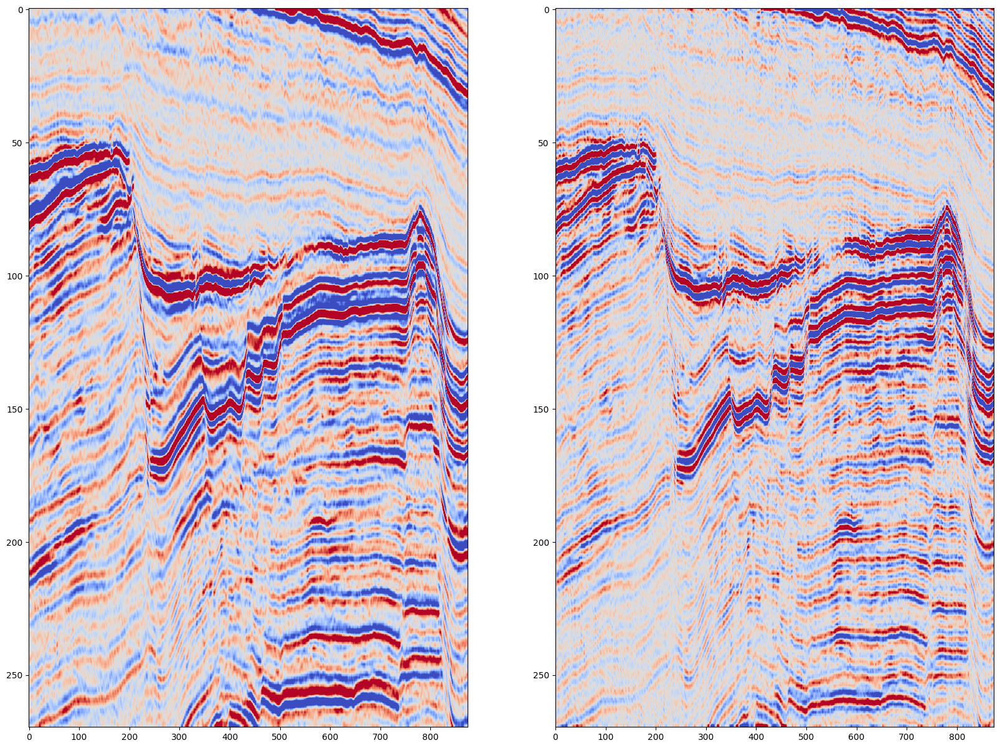

In [28]:
fig = plt.figure(figsize=(20,15))
ax1 = plt.subplot(121)
vm = np.percentile(data, 95)
ax1.imshow(data[0,:,:].T, cmap='coolwarm', aspect='auto', vmin=-vm, vmax=vm)
ax2 = plt.subplot(122)
vm = np.percentile(diff2, 95)
ax2.imshow(diff2[0,:,:].T, cmap='coolwarm', aspect='auto', vmin=-vm, vmax=vm)
plt.show()

## 4.1.4.  Atrribute 4- Coherency

As we discussed in lecture 6, discontinuity attributes are really important, and the algorithms to compute them are often trade-secrets in seismic interpretation software. In this part of the exercise we are using some code from a Github tutorial which shows a number of ways to calculate discontinuity attributes- https://github.com/seg/tutorials-2015/blob/master/1512_Semblance_coherence_and_discontinuity/writeup.md

In this exercise we are going to use the "marfurt semblance". Semblance (also known as coherence) is a measure of how similar seismic traces are to each other. This code is slow... so we are only going to calculate coherence for a few time slices. 


In [29]:

# cnt = 1

def marfurt_semblance(region):
    global cnt
    # We'll need an ntraces by nsamples array
    # This stacks all traces within the x-y "footprint" into one
    # two-dimensional array.
    # print(region.shape)

    # print(region.shape)
    
    if cnt == 1: 
        print(f"here..... {region.shape} ----> \n")
        print(region[0:1, 0:1, :])

        # print(region)
        # print('\n\n')

        print(region[:, :, 0][0][0])
        print(region[:, :, 1][0][0])
        print(region[:, :, 2][0][0])
        print(region[:, :, 3][0][0])
        print(region[:, :, 4][0][0])
        print(region[:, :, 5][0][0])
        print(region[:, :, 6][0][0])
        print(region[:, :, 7][0][0])
        print(region[:, :, 8][0][0])

        print('\n\n')
    
    cnt += 1 

    region = region.reshape(-1, region.shape[-1])

    # print(region.shape)
    ntraces, nsamples = region.shape

    square_of_sums = np.sum(region, axis=0)**2
    sum_of_squares = np.sum(region**2, axis=0)
    sembl = square_of_sums.sum() / sum_of_squares.sum()

    # return region
    res = sembl / ntraces
    print(res.shape)
    return res


def moving_window(data, window, func):
    # `generic_filter` will give the function 1D input. We'll reshape it for convinence
    # print(data.shape, window)
    print(data.shape)
    wrapped = lambda region: func(region.reshape(window))
    
    # Instead of an explicit for loop, we'll use a scipy function to do the same thing
    # The boundaries will be handled by "reflecting" the data, by default
    return scipy.ndimage.generic_filter(input=data, function=wrapped, size=window)

Due to the processing cost of coherency we will only be running this on 15 time-slices. You can run this for more layers if you like, but it may take a while. An applied eaxmple is shown below.

In [57]:
np.array([[[1, 2, 3], [4, 5, 6], [7, 8, 9]]])

array([[[1, 2, 3],
        [4, 5, 6],
        [7, 8, 9]]])

In [55]:
import numpy as np
from scipy import ndimage

def my_func(values):
   print(values, len(values))
   return sum(values) / len(values)

# Create a 2D array (image)
# image = np.array([[1, 2, 3], [4, 5, 6], [7, 8, 9]])
# image = np.array([[[1, 2, 3], [4, 5, 6], [7, 8, 9]]])

# Create a sample 2D array (image)
image = np.array([[1, 2, 3],
                   [4, 5, 6],
                   [7, 8, 9]]).reshape(3, 3, 1)

# Define the footprint
footprint = np.ones((3, 3, 1))

# # Apply the generic_filter function
# result = ndimage.generic_filter(input=image, 
#                                 function=my_func,
#                                 footprint=footprint,
#                                 mode='constant',
#                                 cval=-1,
#                                 origin=0)
result = ndimage.generic_filter(input=image,
                                function=my_func,
                                size=(3, 3, 1),
                                mode='reflect',
                                # cval=-1,
                                origin=0)

print('\n', footprint)
print(image, '\n')
print(result)

[1. 1. 2. 1. 1. 2. 4. 4. 5.] 9
[1. 2. 3. 1. 2. 3. 4. 5. 6.] 9
[2. 3. 3. 2. 3. 3. 5. 6. 6.] 9
[1. 1. 2. 4. 4. 5. 7. 7. 8.] 9
[1. 2. 3. 4. 5. 6. 7. 8. 9.] 9
[2. 3. 3. 5. 6. 6. 8. 9. 9.] 9
[4. 4. 5. 7. 7. 8. 7. 7. 8.] 9
[4. 5. 6. 7. 8. 9. 7. 8. 9.] 9
[5. 6. 6. 8. 9. 9. 8. 9. 9.] 9

 [[[1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]]

 [[1.]
  [1.]
  [1.]]]
[[[1]
  [2]
  [3]]

 [[4]
  [5]
  [6]]

 [[7]
  [8]
  [9]]] 

[[[2]
  [3]
  [3]]

 [[4]
  [5]
  [5]]

 [[6]
  [7]
  [7]]]


In [73]:
np.ones((3, 3, 9)), np.ones((3, 3))

(array([[[1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1.]],
 
        [[1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1.]],
 
        [[1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1.]]]),
 array([[1., 1., 1.],
        [1., 1., 1.],
        [1., 1., 1.]]))

In [43]:
image.shape

(1, 3, 3)

array([[[1],
        [2],
        [3]],

       [[4],
        [5],
        [6]],

       [[7],
        [8],
        [9]]])

In [46]:
import numpy as np
from scipy.ndimage import generic_filter

# Define a simple 3x3 averaging filter function
def average_filter(values):
    print(values, np.mean(values))
    return np.mean(values)

# Create a sample 2D array (image)
image = np.array([[1, 2, 3],
          [4, 5, 6],
          [7, 8, 9]]).reshape(3, 3, 1)

# Apply the average filter using generic_filter
result = generic_filter(image, function=average_filter, size=3)

# Print the original image and the result
print("Original Image:")
print(image)
print("\nResult after applying the average filter:")
print(result)

[1. 1. 1. 1. 1. 1. 2. 2. 2. 1. 1. 1. 1. 1. 1. 2. 2. 2. 4. 4. 4. 4. 4. 4.
 5. 5. 5.] 2.3333333333333335
[1. 1. 1. 2. 2. 2. 3. 3. 3. 1. 1. 1. 2. 2. 2. 3. 3. 3. 4. 4. 4. 5. 5. 5.
 6. 6. 6.] 3.0
[2. 2. 2. 3. 3. 3. 3. 3. 3. 2. 2. 2. 3. 3. 3. 3. 3. 3. 5. 5. 5. 6. 6. 6.
 6. 6. 6.] 3.6666666666666665
[1. 1. 1. 1. 1. 1. 2. 2. 2. 4. 4. 4. 4. 4. 4. 5. 5. 5. 7. 7. 7. 7. 7. 7.
 8. 8. 8.] 4.333333333333333
[1. 1. 1. 2. 2. 2. 3. 3. 3. 4. 4. 4. 5. 5. 5. 6. 6. 6. 7. 7. 7. 8. 8. 8.
 9. 9. 9.] 5.0
[2. 2. 2. 3. 3. 3. 3. 3. 3. 5. 5. 5. 6. 6. 6. 6. 6. 6. 8. 8. 8. 9. 9. 9.
 9. 9. 9.] 5.666666666666667
[4. 4. 4. 4. 4. 4. 5. 5. 5. 7. 7. 7. 7. 7. 7. 8. 8. 8. 7. 7. 7. 7. 7. 7.
 8. 8. 8.] 6.333333333333333
[4. 4. 4. 5. 5. 5. 6. 6. 6. 7. 7. 7. 8. 8. 8. 9. 9. 9. 7. 7. 7. 8. 8. 8.
 9. 9. 9.] 7.0
[5. 5. 5. 6. 6. 6. 6. 6. 6. 8. 8. 8. 9. 9. 9. 9. 9. 9. 8. 8. 8. 9. 9. 9.
 9. 9. 9.] 7.666666666666667
Original Image:
[[[1]
  [2]
  [3]]

 [[4]
  [5]
  [6]]

 [[7]
  [8]
  [9]]]

Result after applying the average filter:
[[[

In [28]:
result[0][0]

2

In [26]:
np.mean([1,1,2,1,1,2,4,4,5])

2.3333333333333335

In [22]:
# due to processing cost we only run this on 15 layers
# marfurt = moving_window(data[:,:,100:115], (3, 3, 9), marfurt_semblance)

cnt = 1 
marfurt = moving_window(data[:,:,100:101], (3, 3, 9), marfurt_semblance)

(493, 874, 1)
here..... (3, 3, 9) ----> 

[[[344.05477905 344.05477905 344.05477905 344.05477905 344.05477905
   344.05477905 344.05477905 344.05477905 344.05477905]]]
344.0547790527344
344.0547790527344
344.0547790527344
344.0547790527344
344.0547790527344
344.0547790527344
344.0547790527344
344.0547790527344
344.0547790527344



()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
()
(

In [15]:
do_nothing = lambda arr: arr.reshape((3, 3, 9))**2
A = scipy.ndimage.generic_filter(input=data[:,:,100:101], function=do_nothing, size=(3, 3, 9))
A, type(A)

In [165]:
marfurt

array([[[0.9745065 , 0.97522897, 0.9729056 , ..., 0.9848378 ,
         0.984483  , 0.98401785],
        [0.9615941 , 0.9640936 , 0.958828  , ..., 0.9846644 ,
         0.98337466, 0.9831547 ],
        [0.9672706 , 0.9707729 , 0.96605927, ..., 0.9860744 ,
         0.983847  , 0.9856281 ],
        ...,
        [0.5680751 , 0.53421634, 0.5077048 , ..., 0.7553222 ,
         0.7538601 , 0.7358156 ],
        [0.67020524, 0.6226167 , 0.5752277 , ..., 0.7328258 ,
         0.71417624, 0.68579835],
        [0.63981825, 0.58389264, 0.54420114, ..., 0.69647694,
         0.67901236, 0.64319247]],

       [[0.966364  , 0.9688123 , 0.96443313, ..., 0.96417415,
         0.9574305 , 0.9618786 ],
        [0.95960635, 0.9628625 , 0.9567016 , ..., 0.96554035,
         0.9584292 , 0.9628187 ],
        [0.96448725, 0.9703365 , 0.964481  , ..., 0.9731973 ,
         0.9658265 , 0.9736301 ],
        ...,
        [0.6601613 , 0.6065041 , 0.56105006, ..., 0.7040855 ,
         0.68159205, 0.6399058 ],
        [0.7

In [164]:
type(marfurt)

numpy.ndarray

ERROR! Session/line number was not unique in database. History logging moved to new session 539


In [50]:
D = data[:,:,100:101]
print(D.shape)

# window0 = D[0:3, 0:3, 0:9]
# print(window0.shape)

# window0 = window0.reshape(-1, window0.shape[-1])
# ntraces, nsamples = window0.shape

# square_of_sums = np.sum(window0, axis=0)**2
# sum_of_squares = np.sum(window0**2, axis=0)
# sembl = square_of_sums.sum() / sum_of_squares.sum()

# print(sembl / ntraces)

(493, 874, 1)


In [49]:
marfurt[:,:,0][0][0]

0.877193

ERROR! Session/line number was not unique in database. History logging moved to new session 529


TypeError: unsupported operand type(s) for -: 'function' and 'function'

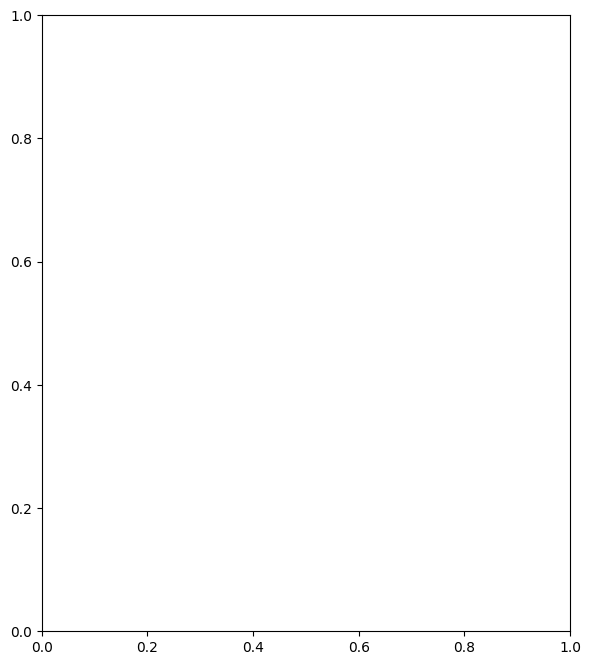

In [46]:
fig = plt.figure(figsize=(15,8))
ax1 = plt.subplot(121)
vm = np.percentile(marfurt, 95)
plt.imshow(marfurt[:,:,0].T, cmap='gray', aspect='auto', vmin=-vm, vmax=vm)
plt.colorbar()
ax2 = plt.subplot(122)
vm = np.percentile(data, 95)
plt.imshow(data[:,:,101].T, cmap='gray', aspect='auto', vmin=-vm, vmax=vm)
plt.show()

In [41]:
marfurt.shape

(493, 874, 1)

IndexError: index 4 is out of bounds for axis 2 with size 1

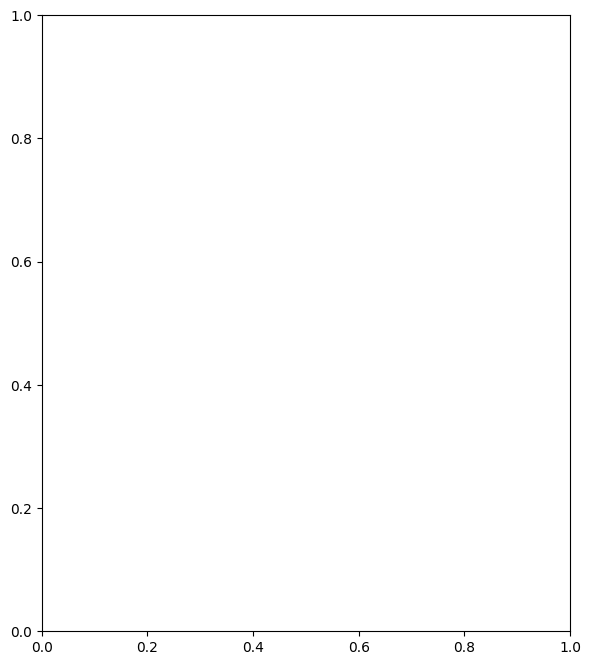

In [39]:
fig = plt.figure(figsize=(15,8))
ax1 = plt.subplot(121)
vm = np.percentile(marfurt, 95)
plt.imshow(marfurt[:,:,4].T, cmap='gray', aspect='auto', vmin=-vm, vmax=vm)
plt.colorbar()
ax2 = plt.subplot(122)
vm = np.percentile(data, 95)
plt.imshow(data[:,:,104].T, cmap='gray', aspect='auto', vmin=-vm, vmax=vm)
plt.show()

**Ex 2: Does coherency help better highlight the features you observed in 4.1.1? If you were a seismic interpreter would you rather interpret these fetures in the amplitude time slices (ie time slices through the original seismic) or the coherence?**

**Ex 3 (optional): You could go a step further and take the derivative of the coherency volume above... remember, any calculation you do is a seismic attribute! You never know... you might design the next big seismic attribute!**

## 4.2. Attribute blending

It can be useful to overlay two or more attributes using transparency to highlight features even further- this is called multi-attribute analysis. Let's first visualise two different attributes side by side to understand visually what is ocurring with some of these attributes and which features they are enhancing

In [22]:
def explore3d_2(data_cube1, data_cube2, cmap1 = 'gray', cmap2 = 'gray'):
    """
    code to visualise two data volumes together
    """
    # https://github.com/seg/tutorials-2015/blob/master/1512_Semblance_coherence_and_discontinuity/Discontinuity_tutorial.ipynb
    source1 = mlab.pipeline.scalar_field(data_cube1)
    source1.spacing = [1, 1, -1]
    
    source2 = mlab.pipeline.scalar_field(data_cube2)
    source2.spacing = [1, 1, -1]

    nx, ny, nz = data_cube1.shape
    
    vm = np.percentile(data_cube1, 95)
    mlab.pipeline.image_plane_widget(source1, plane_orientation='x_axes', 
                                     slice_index=nx//2, colormap= cmap1, vmin=-vm, vmax=vm, plane_opacity=0.1)
    mlab.pipeline.image_plane_widget(source1, plane_orientation='y_axes', 
                                     slice_index=ny//2, colormap= cmap1, vmin=-vm, vmax=vm, plane_opacity=0.1)
    mlab.pipeline.image_plane_widget(source1, plane_orientation='z_axes', 
                                     slice_index=nz//2, colormap= cmap1, vmin=-vm, vmax=vm, plane_opacity=0.1)
    
    vm = np.percentile(data_cube2, 95)
    mlab.pipeline.image_plane_widget(source2, plane_orientation='x_axes', 
                                     slice_index=nx//2, colormap= cmap2, vmin=-vm, vmax=10)
    mlab.pipeline.image_plane_widget(source2, plane_orientation='y_axes', 
                                     slice_index=ny//2, colormap= cmap2, vmin=-vm, vmax=vm)
    mlab.pipeline.image_plane_widget(source2, plane_orientation='z_axes', 
                                     slice_index=nz//2, colormap= cmap2, vmin=-vm, vmax=vm)
    
    mlab.show()

In [23]:
explore3d_2(data, RMS)

An alternative way to use attributes together would be by simply plotting them over each other with the top layer with a higher transparency

In [ ]:
import matplotlib

In [ ]:
# lets create our own colorbar for clearer results
cmap = matplotlib.colors.ListedColormap(['red','white'])
bounds=[0,0.5,1]
norm = matplotlib.colors.BoundaryNorm(bounds, cmap.N)

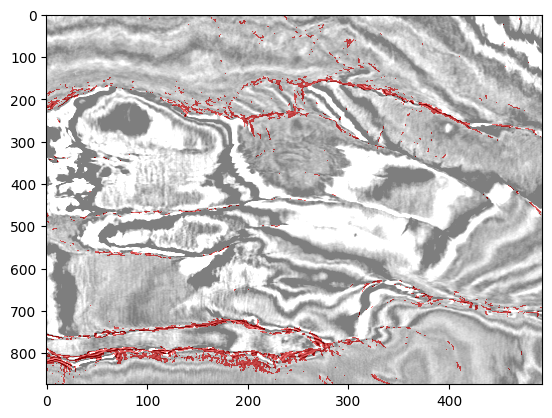

In [ ]:
# plot two datasets together
vm = np.percentile(data, 95)
plt.imshow(data[:,:,104].T, cmap='gray', aspect='auto', vmin=-vm, vmax=vm)

vm = np.percentile(marfurt, 99)
plt.imshow(marfurt[:,:,4].T, cmap=cmap, aspect='auto', alpha = 0.5) # alpha controls transparency

plt.show()

Lastly, something commonly done in seismic interpretation is RGB blending. To achieve this every attribute is assigned either a Red, Blue, or Green colour and these layers and then stacked to produce a color image output that contains information of all 3 attributes. 

**EX 4: Repeat this exercise but with the TNW_small_2 datset we looked at in Exercise 3. Can you reveal any geological features better with attributes than you could with the original seismic volume in Exercise 3?**